In [1]:
!date

Thu Jan 30 12:19:23 PST 2020


# Analysis of SmartSeq2 

In [1369]:
import anndata
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.patches as mpatches


%config InlineBackend.figure_format = 'retina'

In [1370]:
adata = "/home/sina/projects/mop/mop_SMARTseq/out/annotated_adata.h5ad"
adata = anndata.read_h5ad(adata)

In [1371]:
adata

AnnData object with n_obs × n_vars = 6580 × 142446 
    obs: 'cluster_id', 'cluster_label', 'subclass_label', 'class_label', 'cluster_color', 'size'
    var: 'transcript_id', 'gene_id', 'gene_name'

# Isoform adata to gene adata

In [1149]:
m = adata.X.todense()

In [1155]:
((m != 0).sum(axis=0)>10).sum()

111775

In [1372]:
def isoform2gene(adata):
    mtx = adata.X.todense()
    #zero_mask = np.asarray(mtx.sum(axis=0)>10)[0]
    zero_mask = np.asarray((mtx != 0).sum(axis=0)>9)[0] # filters out isoforms that are in less than 10 cells
    print("Number of isoforms in > 9 cells: {:,}".format((zero_mask).sum()))
    
    cell_mask = "nan" == adata.obs.cluster_id.values
    print("Number of cells that do not map to a cluster: {:,}".format(cell_mask.sum()))
    
    isoform = adata.copy()
    isoform = isoform[~cell_mask, zero_mask]
    isoform.var = isoform.var.reset_index(drop=True)
    genes = isoform.var.drop_duplicates("gene_id")["gene_id"].astype('str')
    gene_names = isoform.var.drop_duplicates("gene_id")["gene_name"].astype('str')
    ngenes = genes.shape[0]
    transcripts = isoform.var.transcript_id.unique().astype('str')
    ntranscripts = transcripts.shape[0]
    cells = isoform.obs.index.unique().values
    ncells = cells.shape[0]
    
    print("Number of transcripts: {:,}".format(ntranscripts))
    print("Number of genes      : {:,}".format(ngenes))
    print("Number of cells      : {:,}".format(ncells))
    
    txn_indices = isoform.var.index.values.astype(int)
    t2idx = dict(zip(transcripts, txn_indices))
    g2tidx = isoform.var.groupby("gene_id")["transcript_id"].apply(lambda x: [t2idx[i] for i in x])
    mtx = np.zeros((ncells, ngenes))
    X = isoform.X.todense()
    for idx, g in enumerate(genes):
        txns = g2tidx[g]
        sub_mtx = X[:, txns].sum(axis=1)
        mtx[:,idx] = np.asarray(sub_mtx)[:,0]
        if idx%4000 == 0:
            print(idx)
            
    var = pd.DataFrame({'gene_id':genes, "gene_name":gene_names})
    gene = anndata.AnnData(X=csr_matrix(mtx), obs=isoform.obs, var=var)
    return [isoform, gene]

In [1373]:
%%time
isoform, gene = isoform2gene(adata)

Number of isoforms in > 9 cells: 112,452
Number of cells that do not map to a cluster: 297
Number of transcripts: 112,452
Number of genes      : 39,786
Number of cells      : 6,283
0
4000
8000
12000
16000
20000
24000
28000
32000
36000


Transforming to str index.


CPU times: user 1min 31s, sys: 21 s, total: 1min 52s
Wall time: 1min 52s


In [1374]:
isoform.write("initial_analysis/isoform.h5ad")
gene.write("initial_analysis/gene.h5ad")

... storing 'gene_name' as categorical


In [1160]:
ncells = isoform.shape[0]
nisoforms = isoform.shape[1]

ngenes = gene.shape[1]

clusters = gene.obs.cluster_label.unique().astype(str)
nclusters = gene.obs.cluster_id.nunique()

In [1161]:
nclusters

61

In [1162]:
isoform.var.index = isoform.var.transcript_id
gene.var.index = gene.var.gene_id

# Isoform gene count distribution

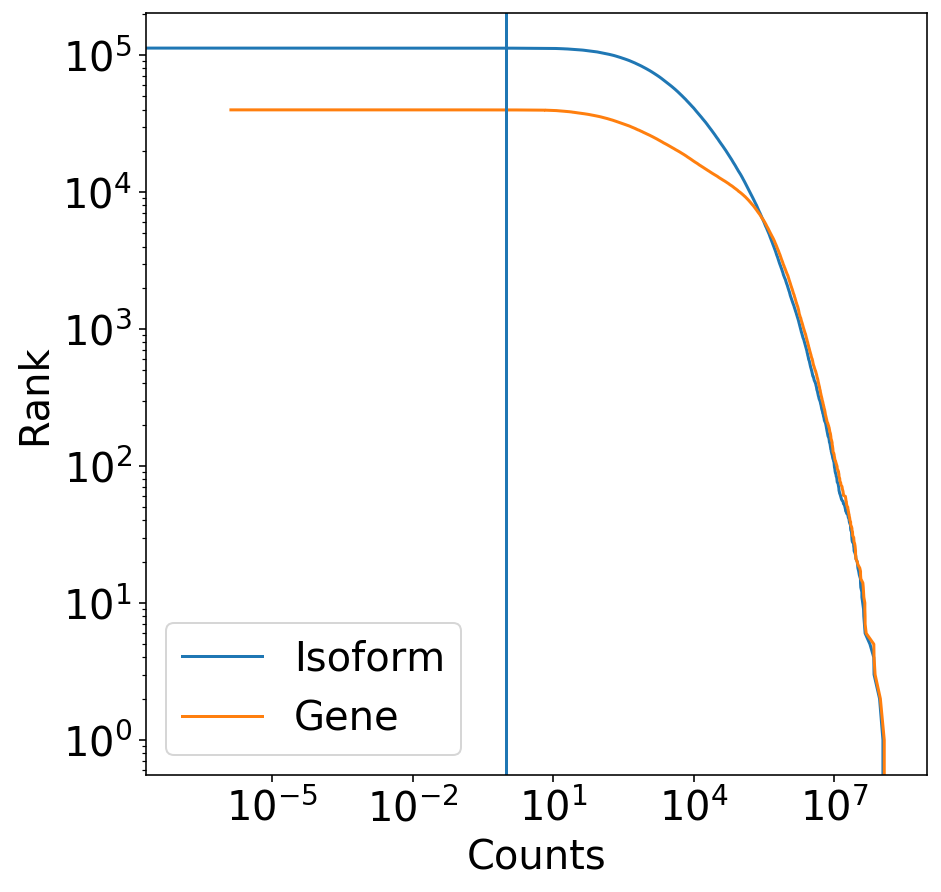

In [1163]:
fig, ax = plt.subplots(figsize=(7,7))
ax.loglog(np.sort(np.asarray(isoform.X.sum(axis=0))[0])[::-1], np.arange(isoform.shape[1]), label="Isoform")
ax.loglog(np.sort(np.asarray(gene.X.sum(axis=0))[0])[::-1], np.arange(gene.shape[1]), label="Gene")
ax.set_xlabel("Counts")
ax.set_ylabel("Rank")
ax.axvline(x=1)

ax.legend()

plt.show()

In [1164]:
gene

AnnData object with n_obs × n_vars = 6283 × 39786 
    obs: 'cluster_id', 'cluster_label', 'subclass_label', 'class_label', 'cluster_color', 'size'
    var: 'gene_id', 'gene_name'

In [1165]:
isoform

AnnData object with n_obs × n_vars = 6283 × 112452 
    obs: 'cluster_id', 'cluster_label', 'subclass_label', 'class_label', 'cluster_color', 'size'
    var: 'transcript_id', 'gene_id', 'gene_name'

# Now we have an isoform matrix and a gene matrix

In [1018]:
import scanpy as sc

In [1166]:
gene.var.index = gene.var.gene_name.values.astype(str)

In [1167]:
gene.var_names_make_unique()

In [1168]:
%%time
sc.tl.rank_genes_groups(gene, 'cluster_label', method='t-test', n_genes = 100)

... storing 'gene_name' as categorical
/home/sina/bin/miniconda3/lib/python3.7/site-packages/scanpy/tools/_rank_genes_groups.py:237: RuntimeWarning: overflow encountered in expm1
  foldchanges = (expm1_func(mean_group) + 1e-9) / (expm1_func(mean_rest) + 1e-9)  # add small value to remove 0's
/home/sina/bin/miniconda3/lib/python3.7/site-packages/scanpy/tools/_rank_genes_groups.py:237: RuntimeWarning: invalid value encountered in true_divide
  foldchanges = (expm1_func(mean_group) + 1e-9) / (expm1_func(mean_rest) + 1e-9)  # add small value to remove 0's
/home/sina/bin/miniconda3/lib/python3.7/site-packages/scanpy/tools/_rank_genes_groups.py:237: RuntimeWarning: overflow encountered in true_divide
  foldchanges = (expm1_func(mean_group) + 1e-9) / (expm1_func(mean_rest) + 1e-9)  # add small value to remove 0's


CPU times: user 29.5 s, sys: 7.07 s, total: 36.5 s
Wall time: 36.5 s


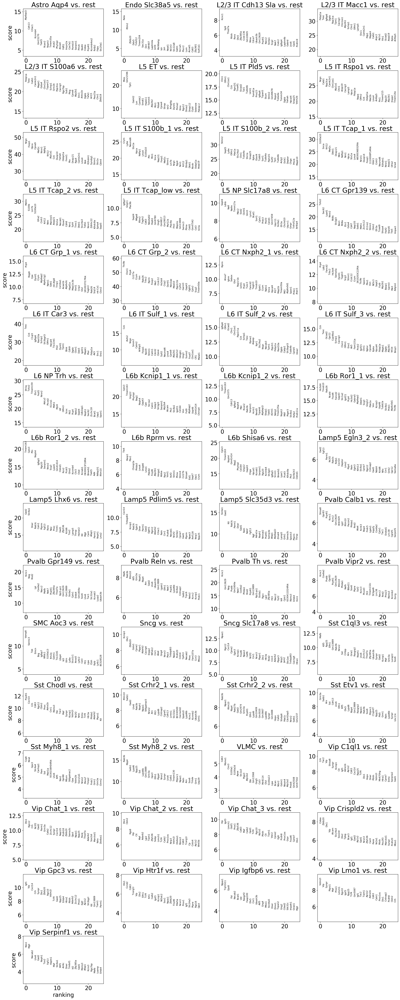

In [1169]:
sc.pl.rank_genes_groups(gene, n_genes=25, sharey=False)

In [1170]:
isoform.var.index = (isoform.var.gene_name.astype(str) + "__" + isoform.var.transcript_id.astype(str)).values

In [1171]:
%%time
sc.tl.rank_genes_groups(isoform, 'cluster_label', method='t-test')

CPU times: user 1min 13s, sys: 14 s, total: 1min 27s
Wall time: 1min 27s


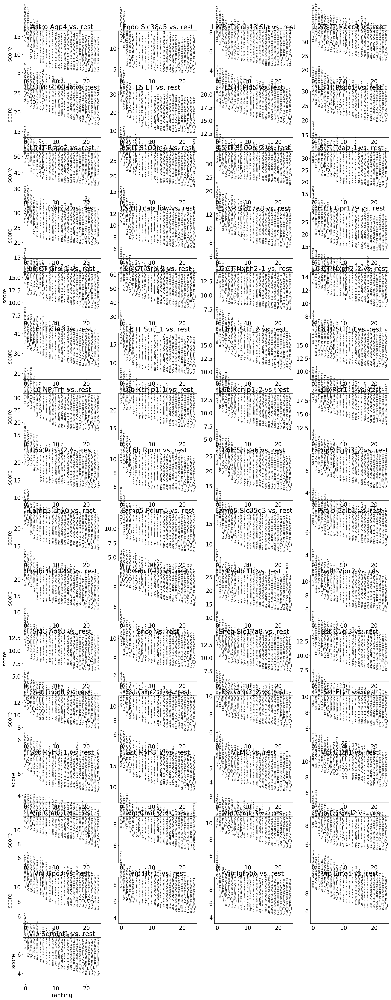

In [1172]:
sc.pl.rank_genes_groups(isoform, n_genes=25, sharey=False)

# Given a list of two things, which register to each other, get the ranks

In [1173]:
a = np.array(["a", "b", "c", "d"])
b = np.array(["a_1", "c_2", "d_1", "c_1"])
c = np.array(['a', 'c', 'd', 'c'])

In [1174]:
def cmp_ranks(a, b, c):
    """
    a = source_list (list of genes)
    b = dest_list (list of isoforms)
    c = mapping of each isoform to its gene
    
    returns a dictionary of dictionarys by 
    """
    xranks = []
    yranks = []
    groups = []
    
    for idx, ele in enumerate(a):
        
        y = np.where(c==ele)[0] # find out where this item is
        x = [idx]*len(y) # duplicate the index to match length
        
        g  = [ele]*len(y)
        
        if len(where) == 0:
            x = np.nan
            y = np.nan
            
        for i in x:
            xranks.append(i)
        for i in y:
            yranks.append(i)
            
        for i in g:
            groups.append(i)
            
    return (xranks, yranks, groups)

In [1175]:
cmp_ranks(a, b, c)

([0, 2, 2, 3], [0, 1, 3, 2], ['a', 'c', 'c', 'd'])

# Get ranks of transcripts vs genes

In [1176]:
ranks = defaultdict(dict)
for cidx, c in enumerate(clusters):
    top_iso = isoform.uns["rank_genes_groups"]["names"][c]
    register = np.array([s.split("__")[0] for s in isoform.uns["rank_genes_groups"]["names"][c]])
    top_gene = gene.uns["rank_genes_groups"]["names"][c]
    
    x, y, g = cmp_ranks(top_gene, top_iso, register)
    ranks[c]["x"] = x
    ranks[c]["y"] = y
    ranks[c]["genes"] = g

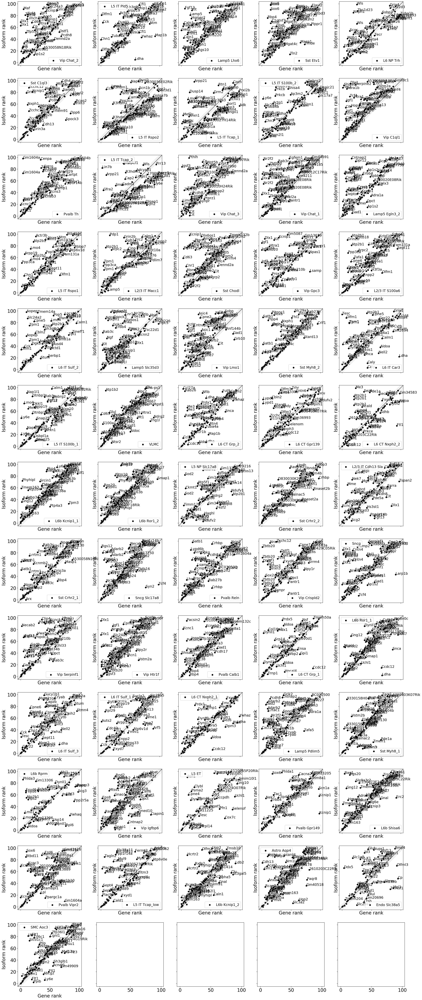

CPU times: user 41.6 s, sys: 2.6 s, total: 44.2 s
Wall time: 41.7 s


In [1177]:
%%time
fig, ax = plt.subplots(13, 5, figsize=(6*5, 6*13), sharex=True, sharey=True)

cnum = 1
diff = 5
fsize = 20

import matplotlib.pyplot as plt
plt.rcParams.update({'font.size': fsize})

ax = ax.ravel()

for cnum in np.arange(nclusters):
    x = ranks[clusters[cnum]]["x"]
    y = ranks[clusters[cnum]]["y"]

    l = ranks[clusters[cnum]]["genes"]

    ax[cnum].scatter(x, y, label=clusters[cnum], color="k")

    for i, txt in enumerate(l):
        if abs(x[i]-y[i]) > diff:
            ax[cnum].annotate(txt, (x[i], y[i]), fontsize=fsize-5)

    ax[cnum].legend(loc='best', fontsize=fsize-5)
    ax[cnum].set_xlabel("Gene rank", fontsize=fsize)
    ax[cnum].set_ylabel("Isoform rank", fontsize=fsize)

    lims = [
        np.min([ax[cnum].get_xlim(), ax[cnum].get_ylim()]),  # min of both axes
        np.max([ax[cnum].get_xlim(), ax[cnum].get_ylim()]),  # max of both axes
    ]

    # now plot both limits against eachother
    ax[cnum].plot(lims, lims, 'k-', alpha=0.75, zorder=0)


    upper = np.array(lims)+diff
    lower = np.array(lims)-diff
    ax[cnum].fill_between(lims, upper, lower, color="grey", alpha = 0.1)
    ax[cnum].set_aspect('equal')
    ax[cnum].set_xlim(lims)
    ax[cnum].set_ylim(lims)
    if cnum == 60:
        break

plt.show()

# Pick genes with many isoforms and plot cell clusters on simplicial elements

In [1178]:
g2t = isoform.var.groupby("gene_id")["transcript_id"].apply(list)

In [1179]:
num_iso_per_gene = g2t.apply(lambda x: len(x)).values
num_unique_isoforms = (num_iso_per_gene==1).sum()

No handles with labels found to put in legend.


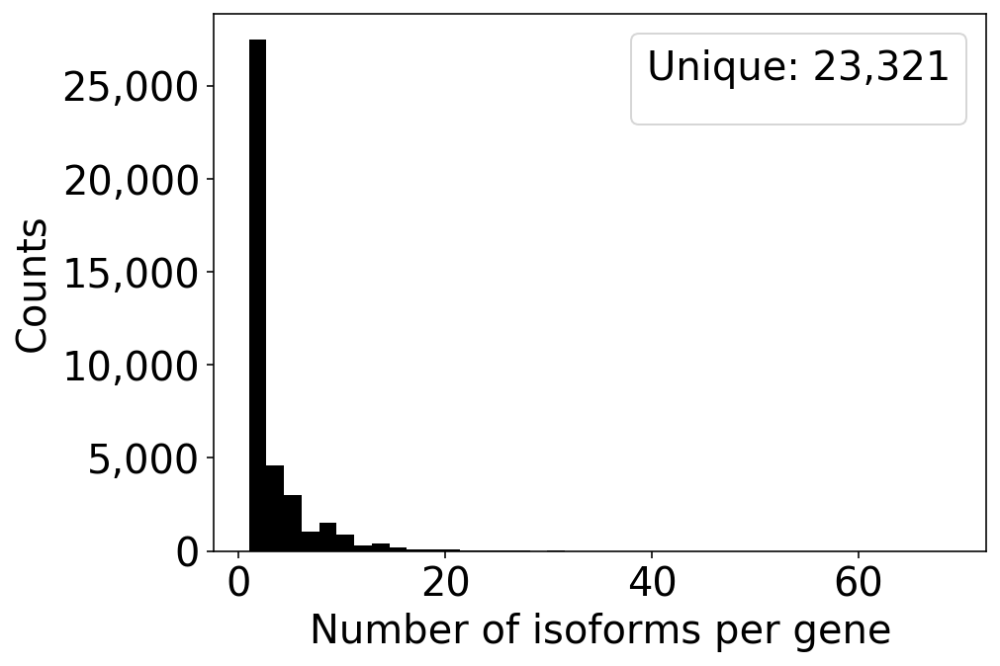

In [1180]:
fig, ax = plt.subplots(figsize=(7,5))
ax.hist(num_iso_per_gene, bins=40, color="k")
ax.set_xlabel("Number of isoforms per gene")
ax.set_ylabel("Counts")
ax.yaxis.set_major_formatter(mpl.ticker.StrMethodFormatter('{x:,.0f}'))

white = mpatches.Patch(color='white', label='Unique isoforms: {:,}'.format(num_unique_isoforms))


ax.legend(title="Unique: {:,}".format(num_unique_isoforms))
plt.show()

In [1181]:
gene.var["txn_list"] = gene.var["gene_id"].map(g2t)

In [1182]:
num_iso = g2t.apply(lambda x: len(x))

In [1183]:
gene.var["num_isoforms"] = gene.var["gene_id"].map(num_iso).astype(int)

In [1184]:
two_isoforms = gene.var[gene.var["num_isoforms"]==2]
three_isoforms = gene.var[gene.var["num_isoforms"]==3]
four_isoforms = gene.var[gene.var["num_isoforms"]==4]

In [1185]:
X = isoform.X.todense()

# Looking at two isoforms

In [1187]:
gene_name = "Trnp1"
try:
    print("{} has {} isoforms".format(gene_name, gene.var.loc[gene_name].num_isoforms))
except:
    print("Gene not found")

Trnp1 has 2 isoforms


In [1188]:
txns  = two_isoforms[two_isoforms.index == gene_name]["txn_list"]
cnum = -1

c = clusters[cnum]
cell_mask = isoform.obs.cluster_label == c
print("Number of cells in cluster: {}".format(cell_mask.sum()))


iso_mask = isoform.var["transcript_id"].isin(txns)

mat = X[:,iso_mask][cell_mask,:]
L1 = mat.sum(axis=1)
norm = mat/L1
if norm.shape[0]*norm.shape[1] == np.isnan(norm).sum():
    print("No effect")

Number of cells in cluster: 7
No effect


matrix([], shape=(7, 0), dtype=float32)

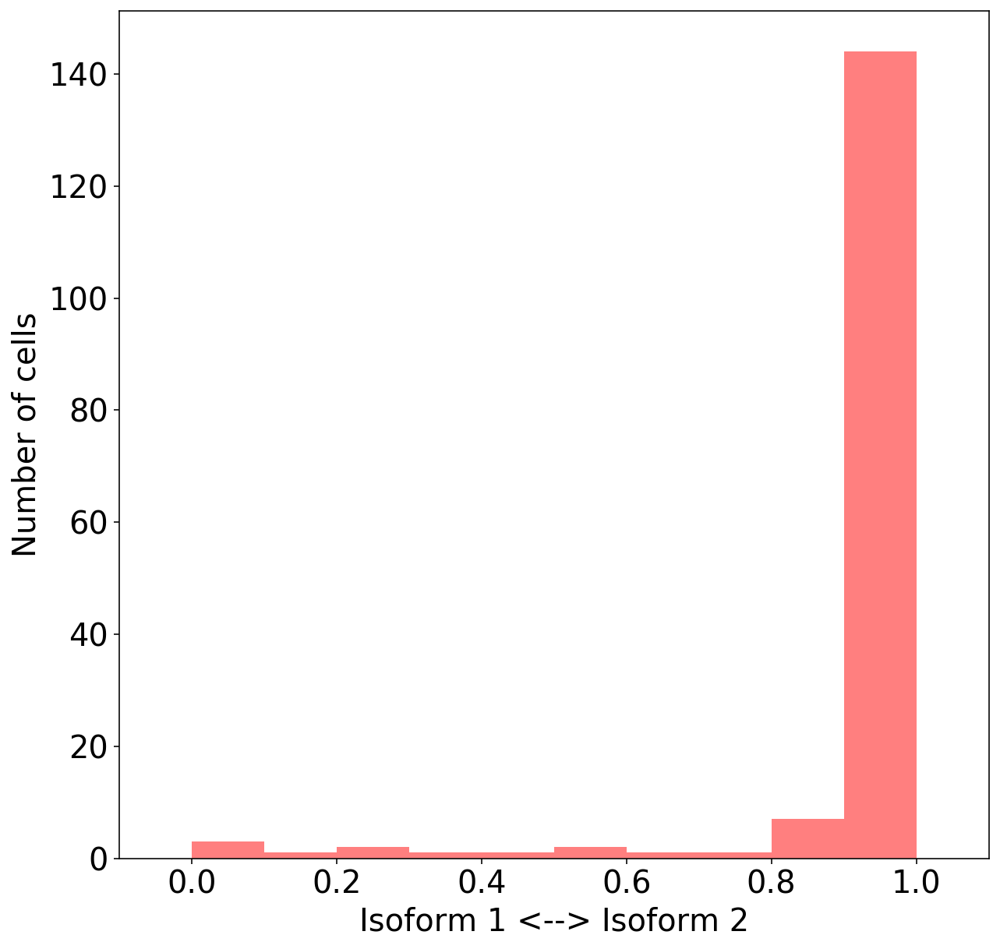

In [993]:
fig, ax = plt.subplots(figsize=(10,10))

ax.hist(norm[:,0], alpha=0.5, color="red")

ax.set_xlim(-0.1, 1.1)
ax.yaxis.set_major_formatter(mpl.ticker.StrMethodFormatter('{x:,.0f}'))
ax.set_xlabel("Isoform 1 <--> Isoform 2")
ax.set_ylabel("Number of cells")
plt.show()

To redo the setup:
Start with genes with two isoforms
For each gene
for each cluster
make norm matrix
take one column and compute mean and variance


# Iterating through all two_isoform genes

In [1064]:
two_isoforms

,gene_id,gene_name,txn_list,num_isoforms
Fasl,ENSMUSG00000000817.10,Fasl,"[ENSMUST00000000834.3, ENSMUST00000193648.1]",2
Aox1,ENSMUSG00000063558.4,Aox1,"[ENSMUST00000001027.6, ENSMUST00000160168.1]",2
Rrp15,ENSMUSG00000001305.5,Rrp15,"[ENSMUST00000001339.5, ENSMUST00000162336.1]",2
Casq1,ENSMUSG00000007122.11,Casq1,"[ENSMUST00000003554.10, ENSMUST00000170638.1]",2
Pax3,ENSMUSG00000004872.15,Pax3,"[ENSMUST00000004994.15, ENSMUST00000172555.1]",2
...,...,...,...,...
Gm45208,ENSMUSG00000109493.1,Gm45208,"[ENSMUST00000207461.1, ENSMUST00000208156.1]",2
Olfr1321,ENSMUSG00000067971.5,Olfr1321,"[ENSMUST00000215373.2, ENSMUST00000215918.1]",2
Uba1y,ENSMUSG00000069053.11,Uba1y,"[ENSMUST00000115894.2, ENSMUST00000190013.6]",2
Gm21860,ENSMUSG00000095366.2,Gm21860,"[ENSMUST00000177893.1, ENSMUST00000238676.1]",2


In [1233]:
X = isoform.X.todense()

In [1305]:
two_markers = defaultdict(dict)

In [1306]:
%%time
for c in clusters[6:7]:
    cell_mask = isoform.obs.cluster_label == c
    print("Number of cells in {} cluster: {}".format(c, cell_mask.sum()))
    two_markers[c]["markers"] = []
    for g in two_isoforms.index.values:
        #print(g)
        data = two_isoforms.loc[g]
        txns  = data["txn_list"]

        iso_mask = isoform.var["transcript_id"].isin(txns)
        
        mat = X[:,iso_mask][cell_mask,:]
        L1 = mat.sum(axis=1)
        norm = mat/L1
        if norm.shape[0]*norm.shape[1] == np.isnan(norm).sum():
            #print("No effect")
            continue
        
        mask = ~np.isnan(norm)
        norm_clean = norm[mask].reshape(-1, 2)
        
        mean = norm_clean[:,0].mean()
        variance = norm_clean[:,0].var()
        #print("mean : {}".format(mean))
        #print("vari : {} \n".format(variance))
        
        if mean != 1 and mean != 0 and len(norm_clean)>10:
            two_markers[c]["markers"].append(g)
    break

Number of cells in L5 IT Rspo2 cluster: 624


/home/sina/bin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in true_divide
  


CPU times: user 19.2 s, sys: 492 ms, total: 19.7 s
Wall time: 19.7 s


In [1307]:
two_isoforms.shape

(4153, 4)

In [1363]:
def get_clean_norm(c, g):
    cell_mask = isoform.obs.cluster_label == c
    print("Number of cells in {} cluster: {}".format(c, cell_mask.sum()))
    print(g)
    data = two_isoforms.loc[g]
    txns  = data["txn_list"]

    iso_mask = isoform.var["transcript_id"].isin(txns)
    
    mat = X[:,iso_mask][cell_mask,:]
    L1 = mat.sum(axis=1)
    norm = mat/L1
    mask = ~np.isnan(norm)
    norm_clean = norm[mask].reshape(-1, 2)
    return mat, norm_clean

In [1334]:
two_markers["L5 IT Rspo2"]["markers"][0:20]

['Aox1',
 'Rrp15',
 'Pax3',
 'Prg4',
 'Wnt10a',
 'Cryba2',
 'Kiss1',
 'Twist2',
 'Slamf1',
 'Dyrk3',
 'Mapkapk2',
 'Ro60',
 'Rdh10',
 'Tmem14a',
 'Lactb2',
 'Pth2r',
 'Maip1',
 'Acadl',
 'Casp8',
 'Sgo2a']

In [1364]:
g = 'Cryba2'
c = "L5 IT Rspo2"
mat, norm = get_clean_norm(c, g)

Number of cells in L5 IT Rspo2 cluster: 624
Cryba2


/home/sina/bin/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: invalid value encountered in true_divide
  if sys.path[0] == '':


In [1367]:
norm = mat

No handles with labels found to put in legend.


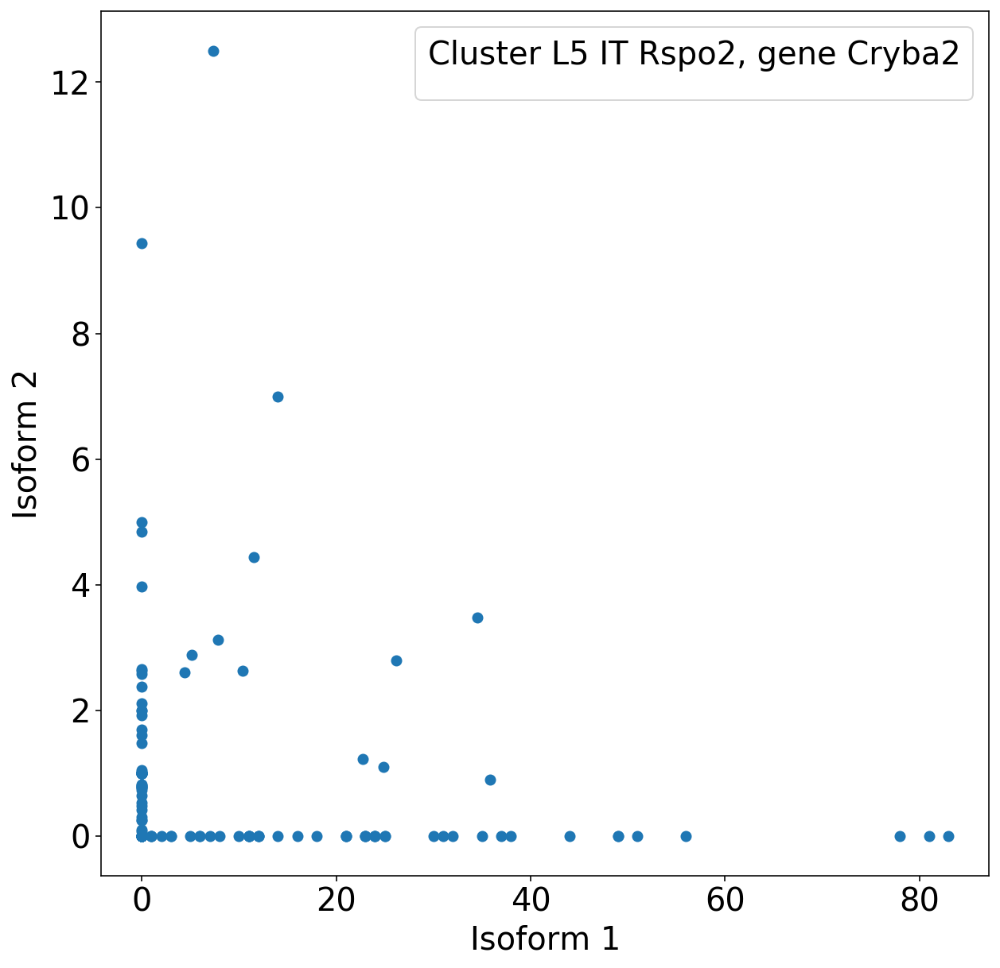

In [1368]:
fig, ax = plt.subplots(figsize=(10,10))
x = np.asarray(norm[:,0])
y = np.asarray(norm[:,1])
ax.scatter(x, y)

ax.set_xlabel("Isoform 1")
ax.set_ylabel("Isoform 2")
ax.legend(title="Cluster {}, gene {}".format(c, g))
plt.show()